In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import sys

sys.path.append('../')
from ConformalMethods import AdaptiveCP, ACP_data, ACP_plots

We want to create a dtaci equivilent where we run multiple dtaci in parrelel with different lookbacks and then choose the most suitable ones. Need to have some form of modular head, which is a generator for the coverage window, then will simply use the l1 loss for a reweighting scheme and you will likley have a scale which you will eventually have to find. 

Below we have the code for the heads.

In [14]:
class AwDtAci_place(AdaptiveCP):
    def __init__(self, coverage):
        self.coverage_target = coverage
        self.interval_size = 50
        self.score_function = lambda xpred, y: (abs(y - xpred))/abs(xpred)
        self.neg_inverse_score =  lambda x_t, Q: (x_t) - (abs(x_t) * Q)
        self.pos_inverse_score = lambda x_t, Q: (x_t) + (abs(x_t) * Q)

    def DtACI_head(self, timeseries_data: tuple, custom_interval: int = None, start_point: int = None, gamma_candidates: np.array = None,  title: str = None):
        '''start_point: The value which the head will start calculating from'''
        
        xpred, y = timeseries_data
        if gamma_candidates is None:
            gamma_candidates = np.array([0.001, 0.004, 0.032, 0.064, 0.128, 0.256, 0.512])

        # we need a vectorised version of l
        l_vec = self.vectorize_l()
        
        candiate_alpha = np.array([[self.coverage_target for _ in gamma_candidates]])
        gamma_weights = np.array([1 for _ in gamma_candidates])
        
        chosen_gamma_index = []
        err_t_list = []
        conformal_sets_list = []
        alpha_t_list = []
        alpha_error_list = []
        B_t_list = []
        
        sigma = 1/(2*custom_interval)
        nu = np.sqrt((3/custom_interval) * (np.log(len(gamma_candidates)*custom_interval) + 2)/((1-self.coverage_target)**2 * self.coverage_target**2))

        # Calculating the scores at each time step
        All_scores = self.score_function(xpred, y)

        for i in range(start_point, len(All_scores)):
            # Calcualting the probability of each gamma from the weights from step t-1.
            Wt = gamma_weights.sum()
            gamma_probabilites = gamma_weights/Wt
            
            # Choosing a alpha from the probabilites from the gamma candidates.
            chosen_alpha_t = np.random.choice(candiate_alpha[-1], p=gamma_probabilites)
            alpha_t_list.append(chosen_alpha_t)
            candiate_alpha_index = np.where(candiate_alpha[-1] == chosen_alpha_t)[0][0]
            chosen_gamma_index.append(candiate_alpha_index)

            Coverage_t = self.C_t(chosen_alpha_t, All_scores, xpred[i], i, custom_interval)
            conformal_sets_list.append(Coverage_t)

            # Yield the conformal set
            yield Coverage_t
            
            err_true = AdaptiveCP.err_t(y[i], Coverage_t)
            err_t_list.append(err_true)

            # TIME FRONTIER -------

            # Smallest interval containg the true value.
            #B_t = 0.5       # To avoid unbound local error will assign B_t a value first
            for possi in np.linspace(1, 0, 1000):
                Cpossi= self.C_t(possi, All_scores, xpred[i], i)
                if Cpossi[0] < y[i] < Cpossi[1]:
                    B_t = possi
                    break
            
            B_t_list.append(B_t)
            
            # Updating the weights.
            new_weights = gamma_weights * np.exp(-nu * np.tanh(l_vec(B_t, candiate_alpha[-1])))
            
            sumW, lenW = sum(new_weights), len(new_weights)
            final_weights = new_weights*(1-sigma) + sumW*(sigma/lenW)
            gamma_weights = final_weights

            # Calculating the coverage and error at each time step, for different alpha values.
            alphai_errors = np.array([AdaptiveCP.err_t(y[i], self.C_t(alpha_i, All_scores, xpred[i], i)) for alpha_i in candiate_alpha[-1]])
            alpha_error_list.append(alphai_errors)

            # Updating the alpha values.
            new_alphas = candiate_alpha[-1] + (gamma_candidates * (self.coverage_target - alphai_errors))
            candiate_alpha = np.vstack((candiate_alpha, new_alphas))
        
        print(B_t_list)
        return False



Below is the AwDtAci method.

In [15]:
class Scalable_Aw(AdaptiveCP):
    def __init__(self, coverage_target):
        self.interval_size = 50
        self.coverage_target = coverage_target

    def new_l_vec(self, optimal_set, given_set):
         val = optimal_set - given_set
         if val < 0:
              return (self.coverage_target) * (-1* val)
         else:
              return (1 - self.coverage_target) * val
    
    def new_vectorize(self):
         return np.vectorize(self.new_l_vec)

    def AwDtAci(self, timeseries_data: tuple, interval_candidates: np.array = None, nu_sigma: tuple = (10**-3, 0.05), title: str = None):
        xpred, y = timeseries_data

        chosen_interval_index = []
        err_t_list = []
        conformal_sets_list = []
        optimal_radius_list = []
        chosen_radius_list = []

        if interval_candidates is None:
            interval_candidates = np.array(range(50, 550, 100))

        # To sync all of the heads we need to start at the max of all the candidates.
        start_point = max(interval_candidates) + 1

        # Create the head and intitialse the weights.
        AwDtAci_place_instance = AwDtAci_place(self.coverage_target)
        DtACI_heads = [AwDtAci_place_instance.DtACI_head(timeseries_data, interval, start_point) for interval in interval_candidates]
        interval_weights = np.array([1 for _ in range(len(interval_candidates))])

        # Scaling the parameters, there is no way these are the best ways.
        sigma = nu_sigma[1]
        nu = nu_sigma[0] # needs to be at least minus two for anything to work.
        
        l_vec = self.new_vectorize()

        none_terminated = True
        i_count = start_point
        
        while none_terminated: # Continues calculating intervals until one of the heads stops.
            head_sets = []
            
            # Create the mass distribution for each head
            Wt = interval_weights.sum()
            interval_probabilites = interval_weights/Wt
        
            # Create a list of the coverages for the different heads.
            try:
                for head in DtACI_heads:
                        head_sets.append(next(head))
            
            except StopIteration: # The head is terminated.
                none_terminated = False
                break # You could but the return statement here

            # Choosing which head to use.
            chosen_set = random.choices(head_sets, weights=interval_probabilites, k=1)[0] # Using random module as numpy can not deal with tuples.
            conformal_sets_list.append(chosen_set)
            chosen_interval_index.append(head_sets.index(chosen_set))

            # TIME FRONTIER -------------

            # Seeing whether result lies within the set.
            err_true = AdaptiveCP.err_t(y[i_count], chosen_set)
            err_t_list.append(err_true)

            # Finding the best possible set. 
            optimal_set_radius = xpred[i_count] - xpred[i_count-1]
            head_set_radius = list(map(lambda Cset: (Cset[1] - Cset[0])/2, head_sets)) #(chosen_set[1] - chosen_set[0])/2

            optimal_radius_list.append(optimal_set_radius)
            chosen_radius_list.append((chosen_set[1] - chosen_set[0]/2))
            
            #l1_error = abs(optimal_set_radius - np.array(head_set_radius))
            head_set_radius = np.array(head_set_radius)
            l1_error = l_vec(optimal_set_radius, head_set_radius)

            # Updating the weights.
            new_weights = interval_weights * np.exp(-1 * nu * l1_error) # Removed negative from previous paper.
            
            sumW, lenW = sum(new_weights), len(new_weights)
            final_weights = new_weights*(1-sigma) + sumW*(sigma/lenW)
            interval_weights = final_weights

            # Incrementing the i-count
            i_count+=1

        # Calculating different averages
        realised_interval_coverage = 1 - pd.Series(err_t_list).rolling(50).mean().mean() # 50 is arbitary and could be improved.
        average_prediction_interval = np.mean([abs(x[1] - x[0]) for x in conformal_sets_list])

        return {
                'model': title if title is not None else 'AwDtACI',
                'coverage_target': self.coverage_target,
                'interval_candidates': interval_candidates,
                'realised_interval_coverage': realised_interval_coverage,
                'average_prediction_interval': average_prediction_interval,
                'optimal_set_radius': optimal_radius_list, 
                'chosen_set_radius': chosen_radius_list,
                'conformal_sets': conformal_sets_list,
                'error_t_list': err_t_list,
                'chosen_interval_index': chosen_interval_index,
                'start_point': start_point,
                'interval_size': 50
            }

Making a nice plotter for this type.

In [16]:
import matplotlib.gridspec as gridspec

@staticmethod
def AwDT_plot(data, dist: tuple, comparison = False):
    y = dist[1]
    error_list = data['error_t_list']
    conformal_sets = data['conformal_sets']
    coverage = data['realised_interval_coverage']
    interval_size = data['interval_size']
    interval_candidates = data['interval_candidates']
    average_prediction_interval = data['average_prediction_interval']

    chosen_interval_index  = data['chosen_interval_index']
    start_point = data['start_point']

    if comparison:
        ACP = AdaptiveCP(data['coverage_target'])
        Dt_data = ACP.DtACI(dist, custom_interval=max(interval_candidates))
        ACI_data = ACP.ACI(dist, 0.05)

    fig = plt.figure(figsize=(30, 20))
    gs = gridspec.GridSpec(5, 2, figure=fig)

    # Realised Coverage
    ax1 = fig.add_subplot(gs[0, :])
    ax1.plot(1 - pd.Series(error_list).rolling(interval_size).mean(), label='AwDtAci', color='b')
    ax1.axhline(coverage, color='b', linestyle='--')
    ax1.set_xlim(min(interval_candidates), len(y) - start_point)
    ax1.set_title('Realised Coverage')

    # Distance between upper and lower bounds
    ax2 = fig.add_subplot(gs[1, :])
    diff = [ele[1]-ele[0] for ele in conformal_sets]
    ax2.plot(diff, label='Distance')
    ax2.axhline(np.mean(diff), color='r', linestyle='--')
    ax2.set_xlim(min(interval_candidates), len(y) - start_point)
    ax2.set_ylim(bottom=0)
    ax2.set_title('Distance between upper and lower bounds')

    # Conformal sets
    ax3 = fig.add_subplot(gs[2:4, :])
    lower, upper = [ele[0] for ele in conformal_sets], [ele[1] for ele in conformal_sets]
    ax3.plot(lower, label='Lower')
    ax3.plot(upper, label='Upper')
    ax3.plot(y[start_point:])
    ax3.set_title('Conformal sets')
    ax3.set_ylim(bottom=np.percentile(lower, 2.5), top=np.percentile(upper, 97.5))
    ax3.set_xlim(0, len(y) - start_point)

    ax4 = fig.add_subplot(gs[4,0])
    ax4.plot(chosen_interval_index,label='chosen_interval_index')
    ax4.set_title('Chosen Interval')

    ax5 = fig.add_subplot(gs[4,1])
    ax5.axhline(average_prediction_interval, label='AwDtAci')

    if comparison:
        # Realised Coverage comparison
        comparison_error_list = Dt_data['error_t_list']
        comparison_coverage = Dt_data['realised_interval_coverage']
        comparison_prediciton_interval = Dt_data['average_prediction_interval']

        ax1.plot(1 - pd.Series(comparison_error_list).rolling(interval_size).mean(), linestyle='--', label='DtAci')
        ax1.axhline(comparison_coverage, color='g', linestyle=':')

        # Distance between upper and lower bounds comparison
        comparison_conformal_sets = Dt_data['conformal_sets']
        comparison_diff = [ele[1]-ele[0] for ele in comparison_conformal_sets]
        ax2.plot(comparison_diff, label='Comparison Distance', linestyle='--')
        ax2.axhline(np.mean(comparison_diff), color='g', linestyle=':', label='comparison average' )

        # Conformal sets comparison
        comparison_lower, comparison_upper = [ele[0] for ele in comparison_conformal_sets], [ele[1] for ele in comparison_conformal_sets]
        ax3.plot(comparison_lower, label='Comparison Lower', linestyle='--')
        ax3.plot(comparison_upper, label='Comparison Upper', linestyle='--')

        ax5.axhline(comparison_prediciton_interval, color='g', label='DtACI')

        aci_error_list = ACI_data['error_t_list']
        aci_coverage = ACI_data['realised_interval_coverage']
        aci_prediction_interval = ACI_data['average_prediction_interval']
        
        ax1.plot(1 - pd.Series(aci_error_list).rolling(interval_size).mean(), linestyle='-.', label='ACI Error')
        ax1.axhline(aci_coverage, color='r', linestyle='-.', label='ACI Coverage')
        
        ax5.axhline(aci_prediction_interval, color='r', label='ACI Prediction Interval')

    ax1.legend()
    ax2.legend()
    ax3.legend()
    ax4.legend()
    ax5.legend()

    plt.show()



In [19]:
single_shift = ACP_data.single_shift(seq_length=750)[0]

In [20]:
t = Scalable_Aw(0.1)
result = t.AwDtAci(single_shift)

[np.float64(0.5025025025025025), np.float64(0.1341341341341341), np.float64(0.7647647647647647), np.float64(0.5025025025025025), np.float64(0.48848848848848847), np.float64(0.3683683683683684), np.float64(0.03503503503503502), np.float64(0.10210210210210213), np.float64(0.5455455455455456), np.float64(0.5905905905905906), np.float64(0.23123123123123124), np.float64(0.1241241241241241), np.float64(0.07907907907907907), np.float64(0.7757757757757757), np.float64(0.1861861861861862), np.float64(0.7787787787787788), np.float64(0.8868868868868869), np.float64(0.968968968968969), np.float64(0.3273273273273274), np.float64(0.45945945945945943), np.float64(0.07107107107107113), np.float64(0.21521521521521525), np.float64(0.4194194194194194), np.float64(1.0), np.float64(0.48348348348348347), np.float64(0.6446446446446447), np.float64(0.6036036036036037), np.float64(0.33333333333333337), np.float64(0.7407407407407407), np.float64(0.2382382382382382), np.float64(0.2382382382382382), np.float64(0.

In [ ]:
lessnu = t.AwDtAci(single_shift, nu_sigma=(0.1, 0.05))

[np.float64(0.8648648648648649), np.float64(0.2232232232232232), np.float64(0.0780780780780781), np.float64(0.4984984984984985), np.float64(0.16416416416416413), np.float64(0.996996996996997), np.float64(0.4194194194194194), np.float64(0.07307307307307309), np.float64(0.6596596596596597), np.float64(0.45245245245245247), np.float64(0.03203203203203209), np.float64(0.8938938938938938), np.float64(0.5305305305305306), np.float64(0.5275275275275275), np.float64(0.6596596596596597), np.float64(0.6566566566566567), np.float64(0.5575575575575575), np.float64(0.4674674674674675), np.float64(0.5565565565565566), np.float64(0.31431431431431434), np.float64(0.020020020020020013), np.float64(0.7747747747747747), np.float64(0.9139139139139139), np.float64(0.996996996996997), np.float64(0.33933933933933935), np.float64(0.13313313313313313), np.float64(0.9159159159159159), np.float64(0.9319319319319319), np.float64(0.8758758758758759), np.float64(0.21121121121121122), np.float64(0.4514514514514515),

In [ ]:
evenlessnu = t.AwDtAci(single_shift, nu_sigma=(0.5, 0.05))

[np.float64(0.8648648648648649), np.float64(0.2232232232232232), np.float64(0.0780780780780781), np.float64(0.4984984984984985), np.float64(0.16416416416416413), np.float64(0.996996996996997), np.float64(0.4194194194194194), np.float64(0.07307307307307309), np.float64(0.6596596596596597), np.float64(0.45245245245245247), np.float64(0.03203203203203209), np.float64(0.8938938938938938), np.float64(0.5305305305305306), np.float64(0.5275275275275275), np.float64(0.6596596596596597), np.float64(0.6566566566566567), np.float64(0.5575575575575575), np.float64(0.4674674674674675), np.float64(0.5565565565565566), np.float64(0.31431431431431434), np.float64(0.020020020020020013), np.float64(0.7747747747747747), np.float64(0.9139139139139139), np.float64(0.996996996996997), np.float64(0.33933933933933935), np.float64(0.13313313313313313), np.float64(0.9159159159159159), np.float64(0.9319319319319319), np.float64(0.8758758758758759), np.float64(0.21121121121121122), np.float64(0.4514514514514515),

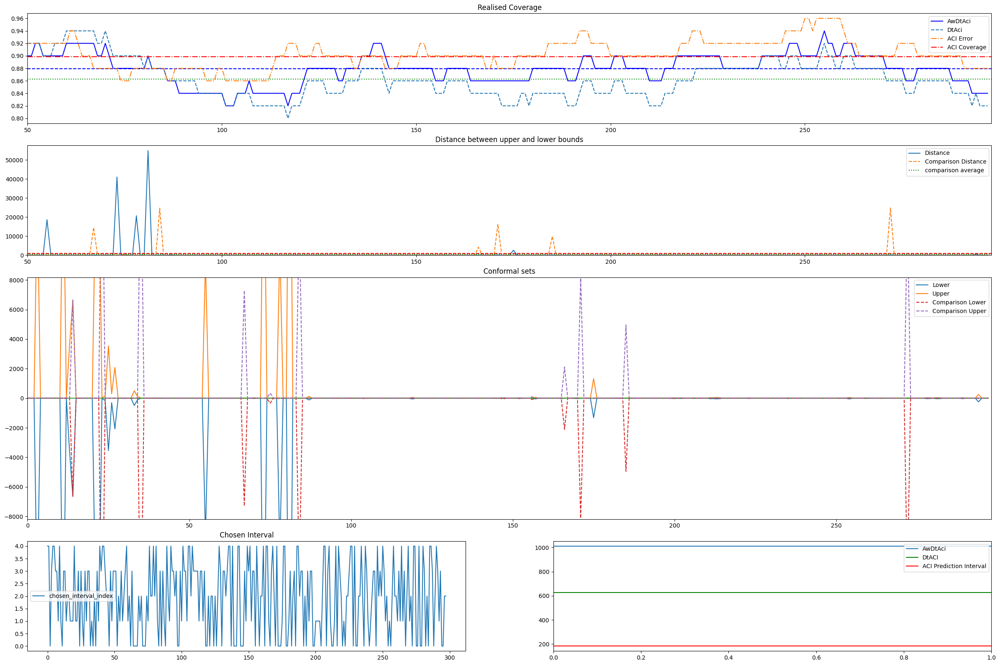

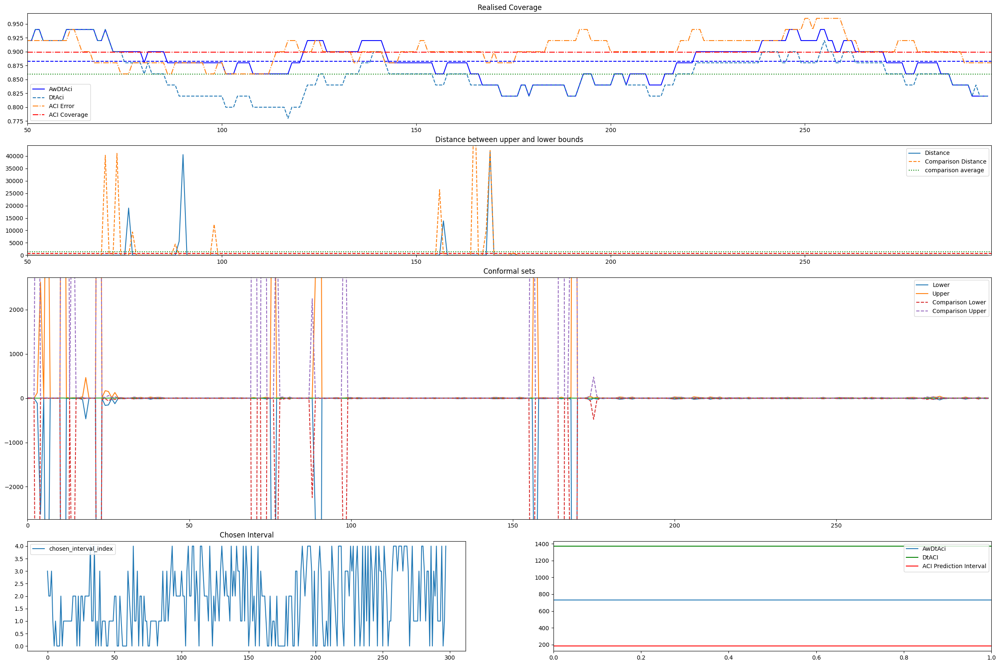

In [ ]:
AwDT_plot(result, single_shift, True)
AwDT_plot(lessnu, single_shift, True)

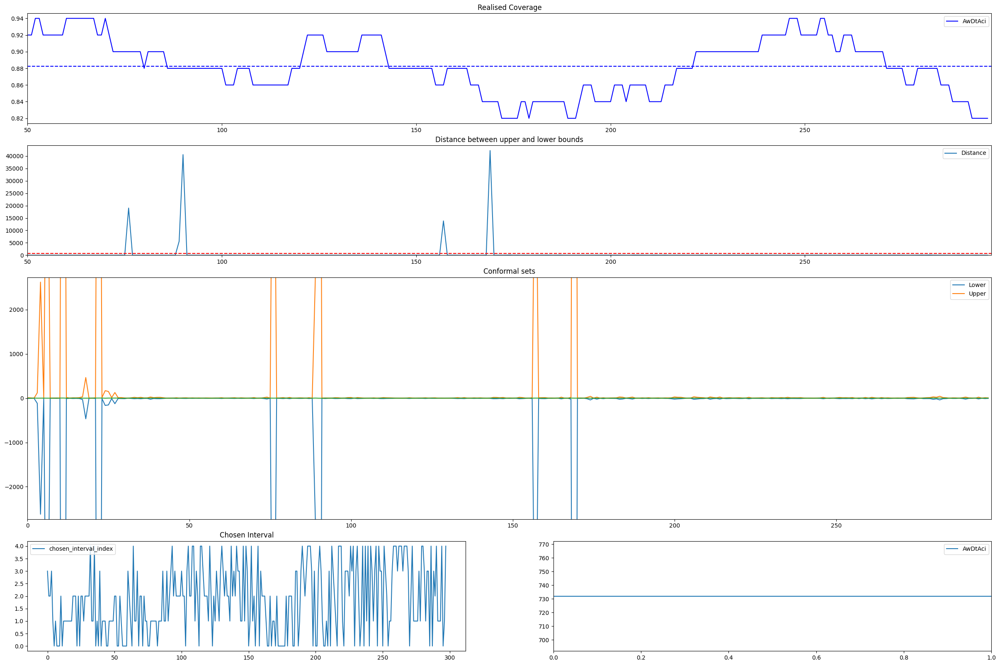

In [ ]:
AwDT_plot(lessnu, single_shift, False)

In [21]:
random_shift = ACP_data.random_multi_shift(1, (2000,2001))[0]
random_result = t.AwDtAci(random_shift)

[np.float64(0.4614614614614615), np.float64(0.9009009009009009), np.float64(0.6946946946946947), np.float64(0.6946946946946947), np.float64(0.6456456456456456), np.float64(0.14214214214214216), np.float64(0.6226226226226226), np.float64(0.055055055055055035), np.float64(0.27127127127127126), np.float64(0.6586586586586587), np.float64(0.019019019019019034), np.float64(0.3473473473473474), np.float64(0.7357357357357357), np.float64(0.2752752752752753), np.float64(0.6736736736736737), np.float64(0.5495495495495495), np.float64(0.20920920920920927), np.float64(0.34434434434434436), np.float64(0.8008008008008007), np.float64(0.9359359359359359), np.float64(0.7077077077077076), np.float64(0.04404404404404405), np.float64(0.4824824824824825), np.float64(0.970970970970971), np.float64(0.7637637637637638), np.float64(0.4674674674674675), np.float64(0.986986986986987), np.float64(0.48048048048048053), np.float64(0.2022022022022022), np.float64(0.97997997997998), np.float64(0.8528528528528528), n

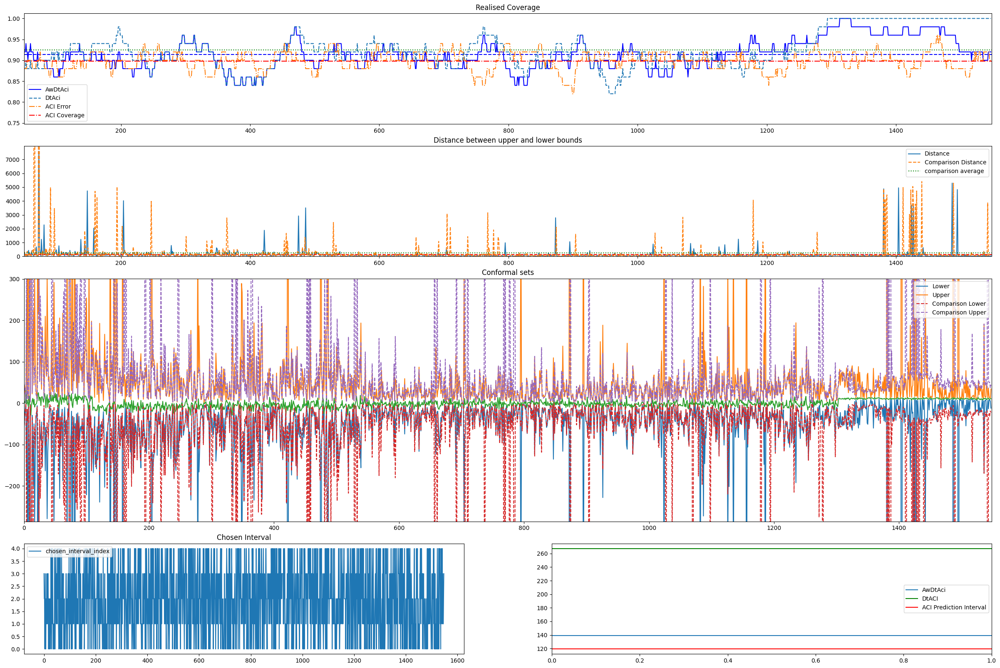

In [22]:
AwDT_plot(random_result, random_shift, True)

# Trying on Multiple Data.

[np.float64(0.7367367367367368), np.float64(0.4974974974974975), np.float64(0.7227227227227226), np.float64(0.09209209209209213), np.float64(0.9379379379379379), np.float64(0.7227227227227226), np.float64(0.7387387387387387), np.float64(0.8658658658658659), np.float64(0.9119119119119119), np.float64(0.30830830830830835), np.float64(0.7807807807807807), np.float64(0.9619619619619619), np.float64(1.0), np.float64(0.948948948948949), np.float64(0.42142142142142147), np.float64(0.1971971971971972), np.float64(0.20820820820820818), np.float64(0.7147147147147147), np.float64(0.998998998998999), np.float64(0.7847847847847848), np.float64(0.978978978978979), np.float64(0.31831831831831836), np.float64(0.15715715715715717), np.float64(0.5695695695695695), np.float64(0.9109109109109109), np.float64(0.93993993993994), np.float64(0.6856856856856857), np.float64(0.4964964964964965), np.float64(1.0), np.float64(0.3013013013013013), np.float64(0.4764764764764765), np.float64(0.004004004004004025), np

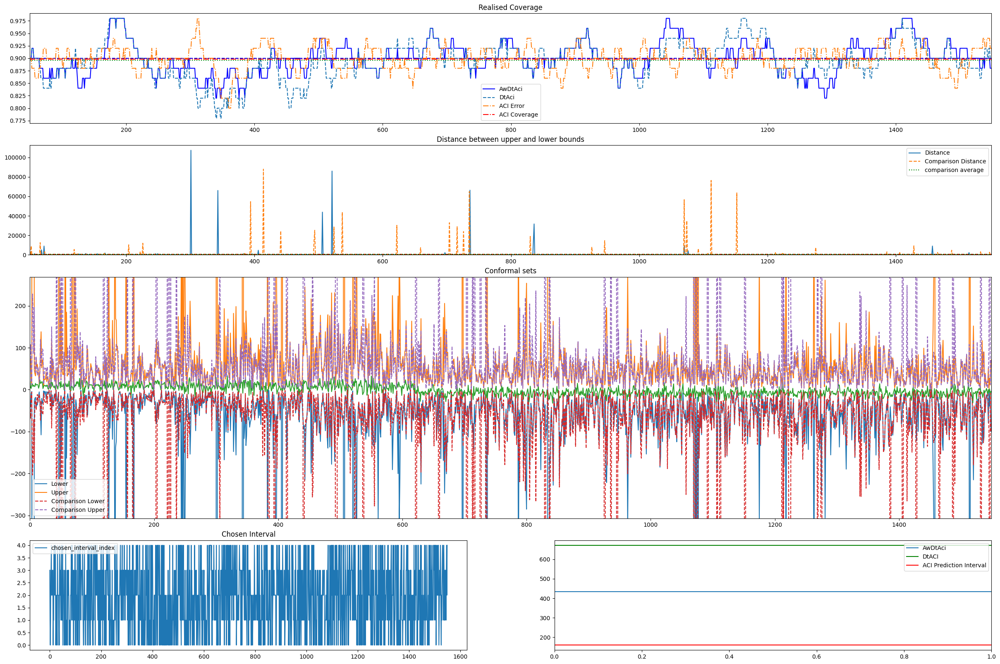

[np.float64(0.8518518518518519), np.float64(0.32932932932932935), np.float64(0.6576576576576576), np.float64(0.39639639639639646), np.float64(0.020020020020020013), np.float64(0.7727727727727728), np.float64(0.17717717717717718), np.float64(0.978978978978979), np.float64(0.7167167167167168), np.float64(0.48048048048048053), np.float64(0.7737737737737738), np.float64(0.4134134134134134), np.float64(0.4134134134134134), np.float64(0.6116116116116116), np.float64(0.8898898898898899), np.float64(0.6816816816816818), np.float64(0.7877877877877878), np.float64(0.6386386386386387), np.float64(0.12112112112112117), np.float64(0.8228228228228228), np.float64(0.8078078078078078), np.float64(0.6486486486486487), np.float64(0.5995995995995996), np.float64(0.94994994994995), np.float64(0.3683683683683684), np.float64(0.040040040040040026), np.float64(0.0880880880880881), np.float64(0.8768768768768769), np.float64(0.39639639639639646), np.float64(0.39639639639639646), np.float64(0.8638638638638638),

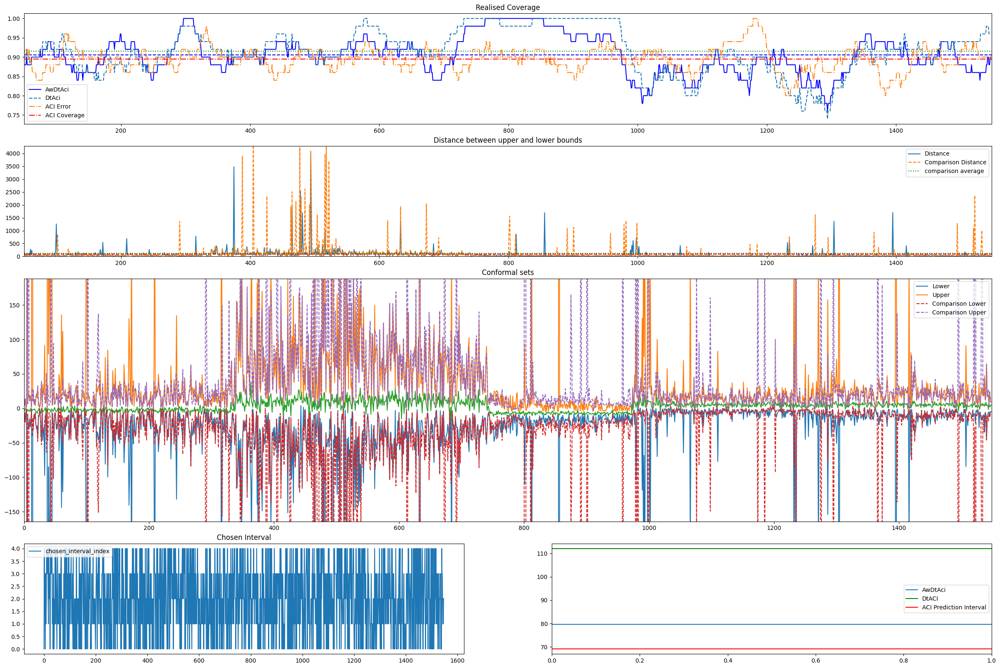

[np.float64(0.7637637637637638), np.float64(0.924924924924925), np.float64(0.7947947947947948), np.float64(0.1711711711711712), np.float64(0.5285285285285286), np.float64(0.9359359359359359), np.float64(0.9719719719719719), np.float64(0.21821821821821819), np.float64(0.6976976976976976), np.float64(0.18318318318318316), np.float64(0.8868868868868869), np.float64(0.5835835835835836), np.float64(0.6396396396396397), np.float64(0.1911911911911912), np.float64(0.6116116116116116), np.float64(0.6646646646646647), np.float64(0.13313313313313313), np.float64(0.30330330330330335), np.float64(1.0), np.float64(0.7667667667667668), np.float64(0.5195195195195195), np.float64(0.8208208208208209), np.float64(0.34434434434434436), np.float64(0.21921921921921927), np.float64(0.6146146146146146), np.float64(0.5055055055055055), np.float64(0.20320320320320318), np.float64(0.4354354354354354), np.float64(0.28828828828828834), np.float64(0.6496496496496497), np.float64(1.0), np.float64(0.2022022022022022)

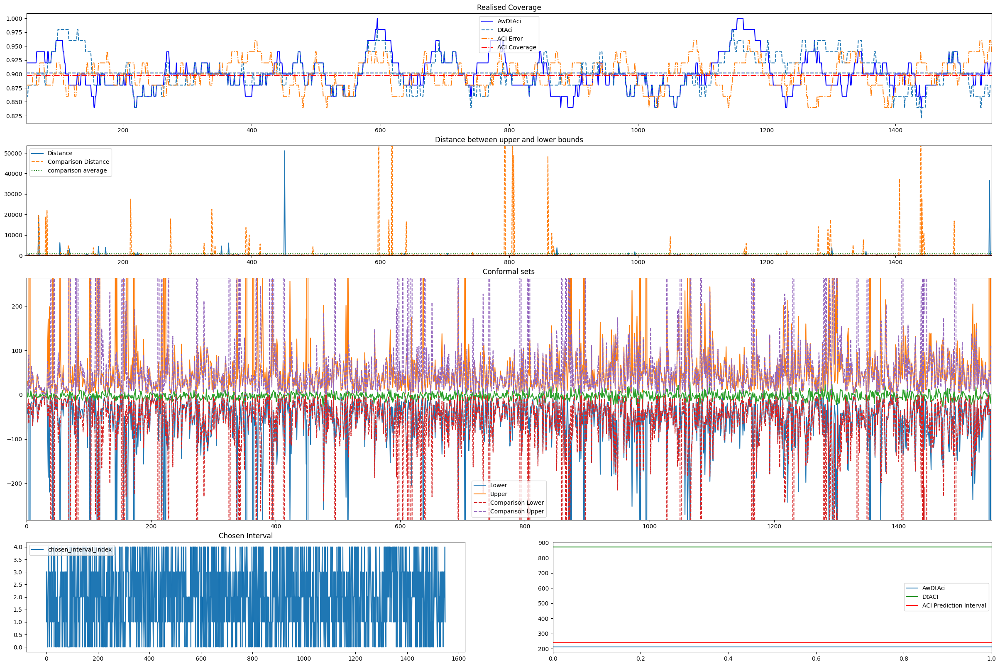

[np.float64(0.16016016016016021), np.float64(0.8928928928928929), np.float64(0.1451451451451452), np.float64(0.6056056056056056), np.float64(0.5435435435435436), np.float64(0.5435435435435436), np.float64(1.0), np.float64(0.6786786786786787), np.float64(0.8938938938938938), np.float64(0.8268268268268268), np.float64(0.18518518518518523), np.float64(1.0), np.float64(0.8458458458458459), np.float64(0.45245245245245247), np.float64(0.5885885885885886), np.float64(0.019019019019019034), np.float64(0.8608608608608609), np.float64(0.7037037037037037), np.float64(0.2482482482482482), np.float64(0.8708708708708709), np.float64(0.6216216216216216), np.float64(0.06006006006006004), np.float64(0.39539539539539537), np.float64(0.5455455455455456), np.float64(0.7607607607607607), np.float64(0.8958958958958959), np.float64(0.30330330330330335), np.float64(0.20320320320320318), np.float64(0.6856856856856857), np.float64(0.7217217217217218), np.float64(0.9429429429429429), np.float64(0.420420420420420

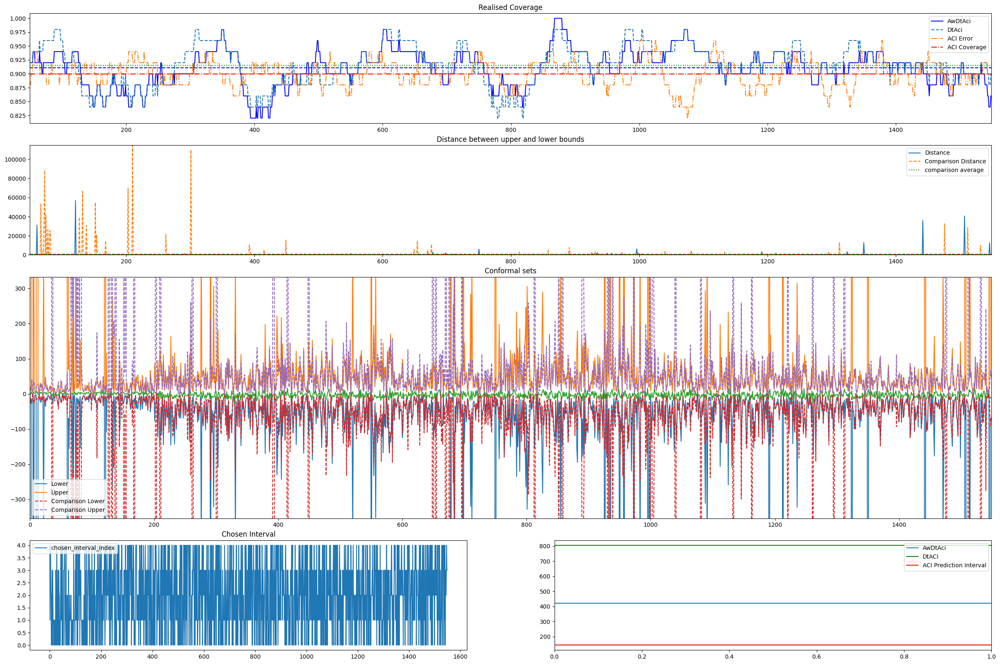

[np.float64(0.45845845845845845), np.float64(1.0), np.float64(0.9239239239239239), np.float64(0.06006006006006004), np.float64(0.37537537537537535), np.float64(0.8788788788788788), np.float64(0.6036036036036037), np.float64(0.06606606606606602), np.float64(0.8218218218218218), np.float64(0.14714714714714716), np.float64(0.4354354354354354), np.float64(0.5735735735735736), np.float64(0.03503503503503502), np.float64(0.965965965965966), np.float64(0.8638638638638638), np.float64(0.056056056056056014), np.float64(0.5585585585585586), np.float64(0.036036036036036), np.float64(0.7917917917917918), np.float64(0.9719719719719719), np.float64(0.8928928928928929), np.float64(0.5865865865865866), np.float64(0.04504504504504503), np.float64(0.7397397397397397), np.float64(0.5285285285285286), np.float64(0.3163163163163163), np.float64(0.06706706706706711), np.float64(0.2632632632632632), np.float64(0.7427427427427428), np.float64(0.16916916916916913), np.float64(0.928928928928929), np.float64(0.9

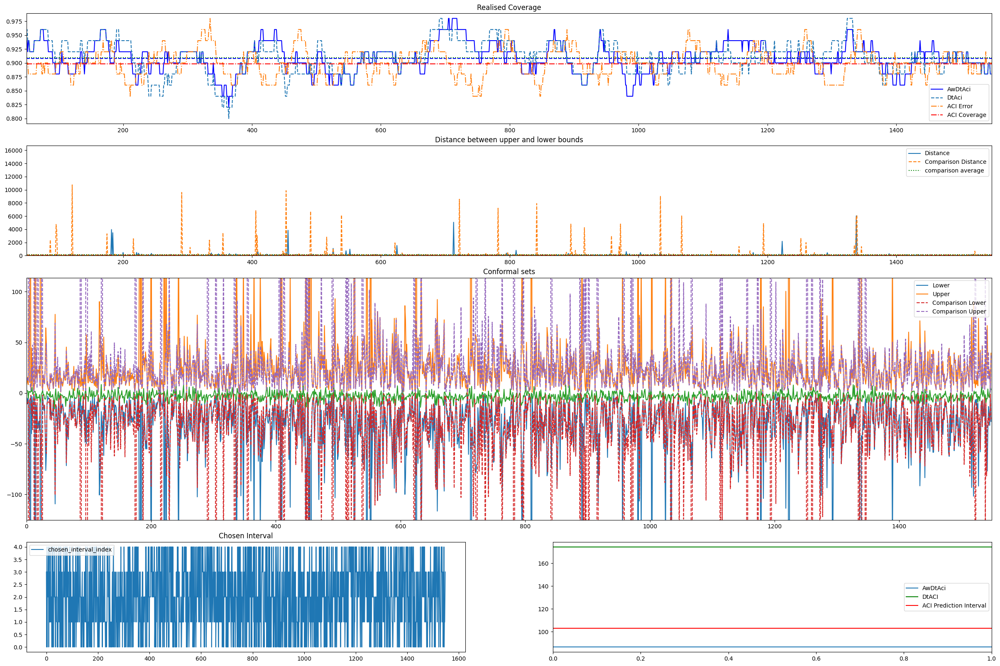

[np.float64(0.28128128128128127), np.float64(0.9089089089089089), np.float64(0.8188188188188188), np.float64(0.5215215215215215), np.float64(0.5075075075075075), np.float64(0.5075075075075075), np.float64(0.3793793793793794), np.float64(0.5305305305305306), np.float64(0.19819819819819817), np.float64(1.0), np.float64(0.6786786786786787), np.float64(0.03203203203203209), np.float64(0.6996996996996997), np.float64(0.7677677677677678), np.float64(0.8968968968968969), np.float64(0.42742742742742745), np.float64(0.10110110110110115), np.float64(0.6726726726726726), np.float64(0.31931931931931934), np.float64(0.8658658658658659), np.float64(0.7397397397397397), np.float64(0.0780780780780781), np.float64(0.8488488488488488), np.float64(0.5375375375375375), np.float64(0.20320320320320318), np.float64(0.1451451451451452), np.float64(0.9669669669669669), np.float64(0.8178178178178178), np.float64(0.7597597597597597), np.float64(0.996996996996997), np.float64(0.9019019019019019), np.float64(0.296

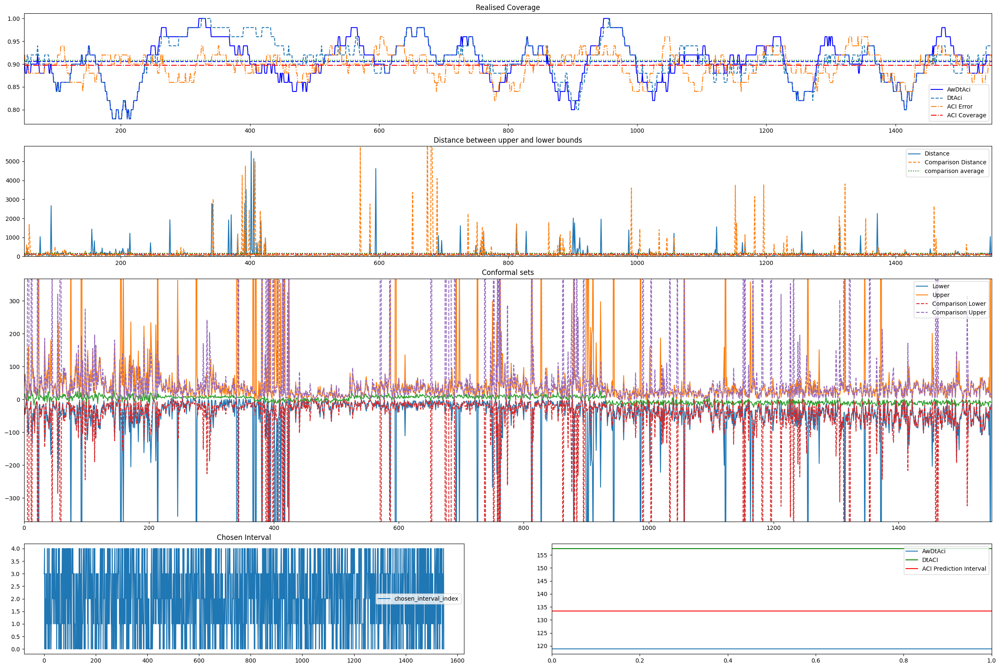

[np.float64(0.13013013013013008), np.float64(0.6586586586586587), np.float64(0.7807807807807807), np.float64(0.7117117117117118), np.float64(0.4404404404404404), np.float64(0.019019019019019034), np.float64(0.26826826826826833), np.float64(0.2482482482482482), np.float64(0.1561561561561562), np.float64(0.8178178178178178), np.float64(0.8208208208208209), np.float64(0.1451451451451452), np.float64(0.12512512512512508), np.float64(0.9109109109109109), np.float64(0.9049049049049049), np.float64(0.8458458458458459), np.float64(0.4194194194194194), np.float64(0.20420420420420426), np.float64(0.018018018018018056), np.float64(0.15915915915915912), np.float64(0.48048048048048053), np.float64(0.010010010010010006), np.float64(0.19519519519519524), np.float64(0.7497497497497497), np.float64(0.20620620620620622), np.float64(0.39239239239239243), np.float64(0.8958958958958959), np.float64(0.5675675675675675), np.float64(0.6126126126126126), np.float64(0.26726726726726724), np.float64(0.9069069069

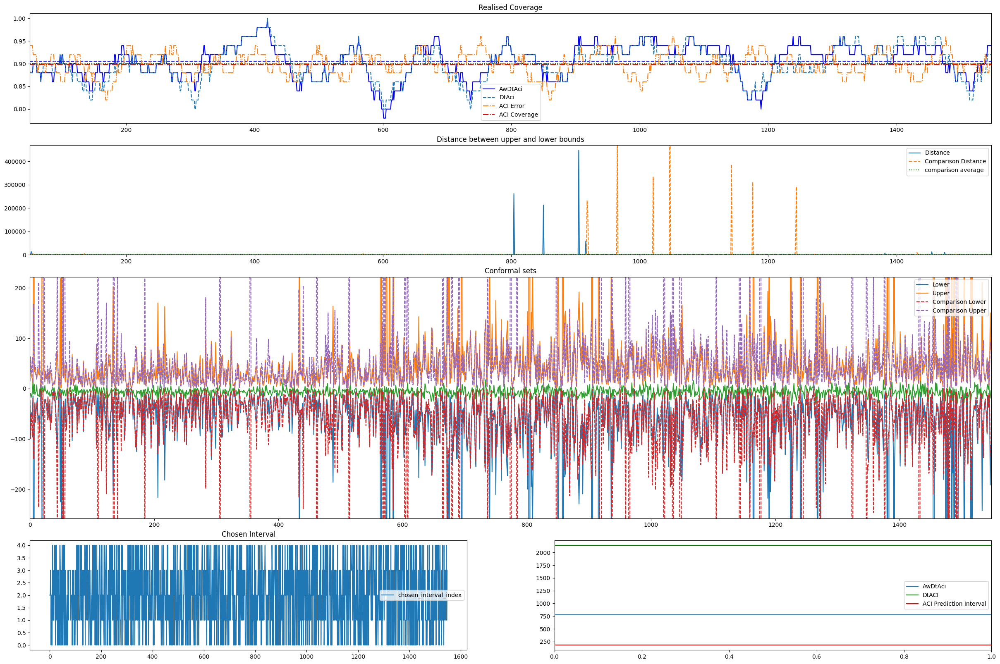

[np.float64(0.06406406406406406), np.float64(0.7597597597597597), np.float64(0.1811811811811812), np.float64(0.2122122122122122), np.float64(0.2542542542542543), np.float64(0.7537537537537538), np.float64(0.01501501501501501), np.float64(0.47547547547547553), np.float64(0.20120120120120122), np.float64(0.3223223223223223), np.float64(0.6036036036036037), np.float64(0.15415415415415412), np.float64(1.0), np.float64(0.5705705705705706), np.float64(0.7627627627627628), np.float64(0.985985985985986), np.float64(0.24524524524524527), np.float64(0.5475475475475475), np.float64(0.8898898898898899), np.float64(0.93993993993994), np.float64(0.6456456456456456), np.float64(0.48348348348348347), np.float64(0.6756756756756757), np.float64(0.7857857857857857), np.float64(0.5795795795795795), np.float64(0.27627627627627627), np.float64(0.26226226226226224), np.float64(0.08408408408408408), np.float64(0.8678678678678678), np.float64(0.7817817817817818), np.float64(0.8308308308308309), np.float64(0.71

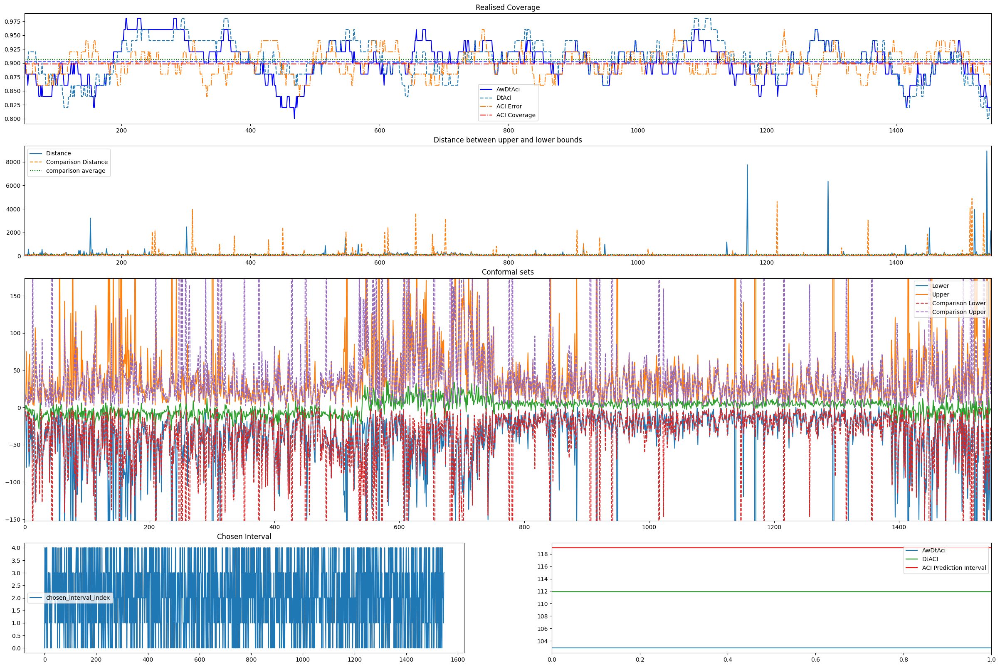

[np.float64(0.8888888888888888), np.float64(0.8758758758758759), np.float64(0.980980980980981), np.float64(0.14114114114114118), np.float64(0.996996996996997), np.float64(1.0), np.float64(0.47347347347347346), np.float64(0.3213213213213213), np.float64(0.93993993993994), np.float64(0.7557557557557557), np.float64(0.20020020020020024), np.float64(0.7897897897897898), np.float64(0.4414414414414415), np.float64(0.8418418418418419), np.float64(0.8248248248248249), np.float64(0.6486486486486487), np.float64(0.31831831831831836), np.float64(0.48948948948948945), np.float64(0.37137137137137133), np.float64(0.8708708708708709), np.float64(0.2852852852852853), np.float64(0.6176176176176176), np.float64(0.1291291291291291), np.float64(0.5415415415415415), np.float64(0.06206206206206211), np.float64(0.05905905905905906), np.float64(0.3433433433433434), np.float64(0.5485485485485486), np.float64(0.2382382382382382), np.float64(0.12112112112112117), np.float64(0.39739739739739743), np.float64(0.198

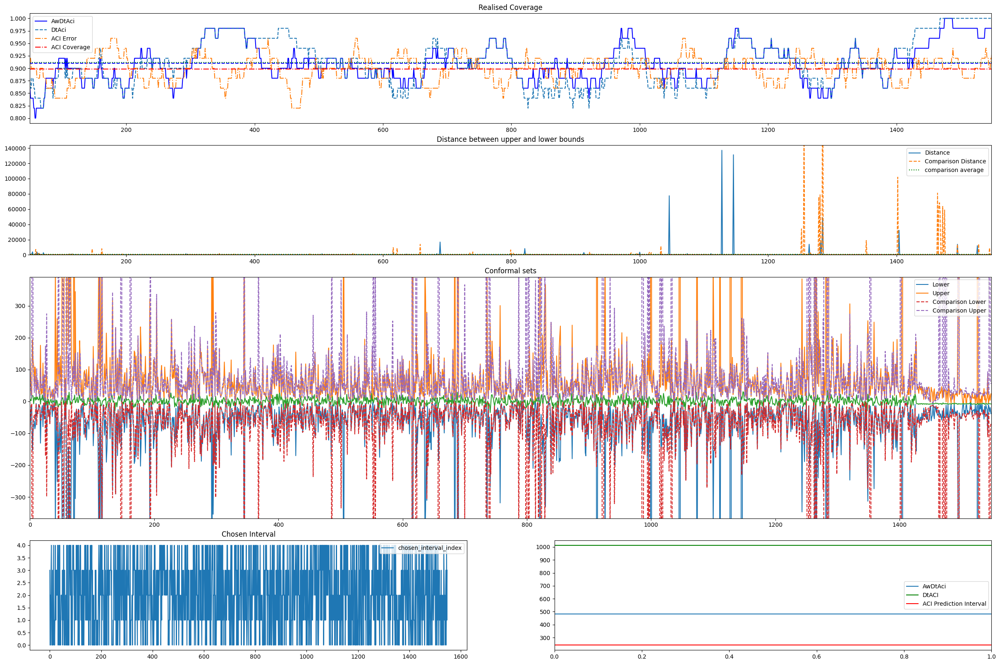

[np.float64(0.5375375375375375), np.float64(0.11111111111111116), np.float64(0.6036036036036037), np.float64(0.5215215215215215), np.float64(0.42142142142142147), np.float64(0.28728728728728725), np.float64(0.5395395395395395), np.float64(0.8048048048048049), np.float64(0.4464464464464465), np.float64(0.4464464464464465), np.float64(0.7977977977977978), np.float64(0.47847847847847846), np.float64(0.4194194194194194), np.float64(0.9099099099099099), np.float64(0.7747747747747747), np.float64(0.25725725725725723), np.float64(0.4244244244244244), np.float64(0.5375375375375375), np.float64(0.2912912912912913), np.float64(0.6866866866866868), np.float64(0.6866866866866868), np.float64(1.0), np.float64(1.0), np.float64(0.37137137137137133), np.float64(0.973973973973974), np.float64(0.3303303303303303), np.float64(0.963963963963964), np.float64(0.7517517517517518), np.float64(0.6296296296296297), np.float64(0.6296296296296297), np.float64(0.5965965965965966), np.float64(0.13313313313313313), 

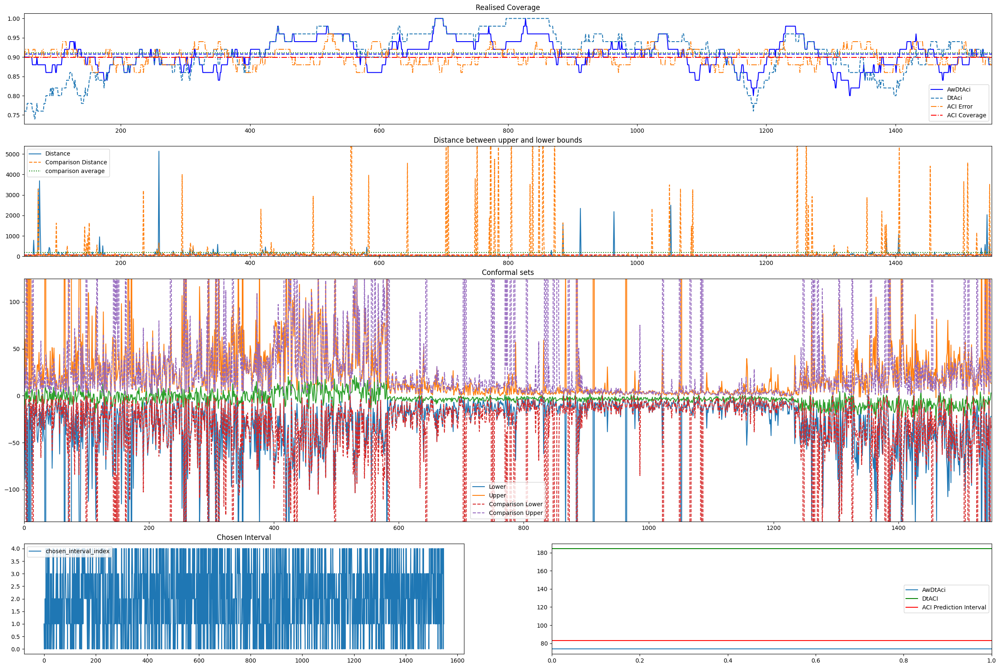

[np.float64(0.8748748748748749), np.float64(0.9189189189189189), np.float64(0.6846846846846847), np.float64(0.6946946946946947), np.float64(0.44344344344344344), np.float64(0.28328328328328334), np.float64(0.7467467467467468), np.float64(0.10010010010010006), np.float64(0.23423423423423428), np.float64(0.8448448448448449), np.float64(0.5065065065065065), np.float64(0.006006006006005982), np.float64(0.6596596596596597), np.float64(0.7207207207207207), np.float64(0.9109109109109109), np.float64(0.3113113113113113), np.float64(0.09209209209209213), np.float64(0.37537537537537535), np.float64(0.16016016016016021), np.float64(0.6736736736736737), np.float64(0.45945945945945943), np.float64(0.02102102102102099), np.float64(0.5685685685685686), np.float64(0.07307307307307309), np.float64(0.5555555555555556), np.float64(0.20620620620620622), np.float64(0.6866866866866868), np.float64(0.049049049049049054), np.float64(0.6116116116116116), np.float64(0.7197197197197197), np.float64(1.0), np.floa

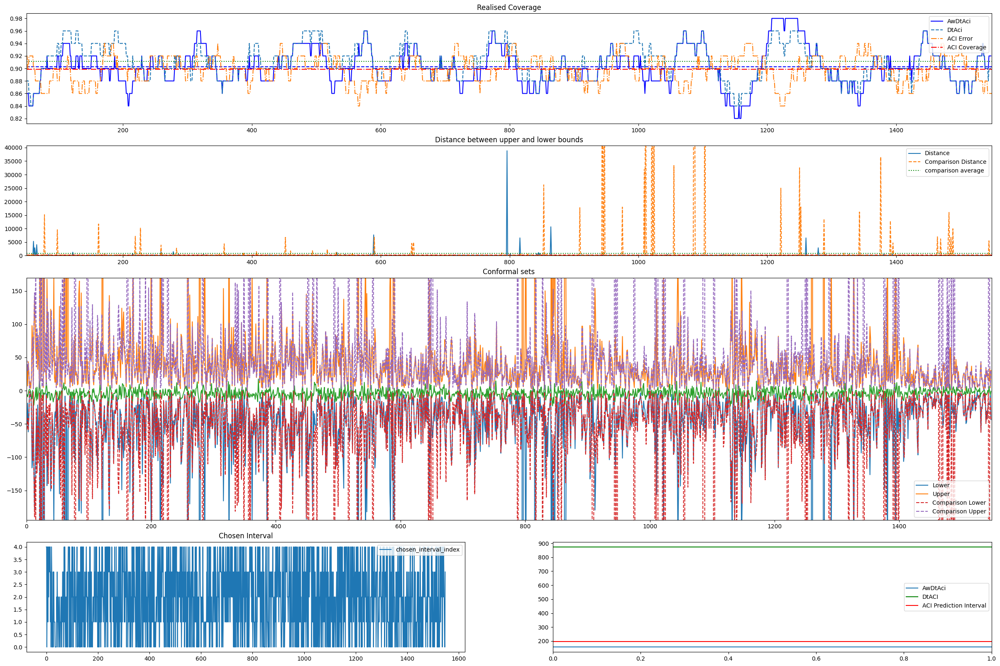

[np.float64(0.46446446446446443), np.float64(0.5725725725725725), np.float64(0.18018018018018023), np.float64(0.017017017017017078), np.float64(0.26826826826826833), np.float64(0.07207207207207211), np.float64(0.7967967967967968), np.float64(0.3253253253253253), np.float64(0.988988988988989), np.float64(0.1191191191191191), np.float64(0.3663663663663663), np.float64(0.4554554554554555), np.float64(0.2652652652652653), np.float64(0.3523523523523524), np.float64(0.9459459459459459), np.float64(0.29829829829829835), np.float64(0.5625625625625625), np.float64(0.39739739739739743), np.float64(0.5205205205205206), np.float64(1.0), np.float64(0.7827827827827828), np.float64(0.5405405405405406), np.float64(0.8008008008008007), np.float64(0.4714714714714715), np.float64(0.6486486486486487), np.float64(0.018018018018018056), np.float64(0.45845845845845845), np.float64(0.4864864864864865), np.float64(0.1191191191191191), np.float64(0.8198198198198199), np.float64(0.8498498498498499), np.float64(0

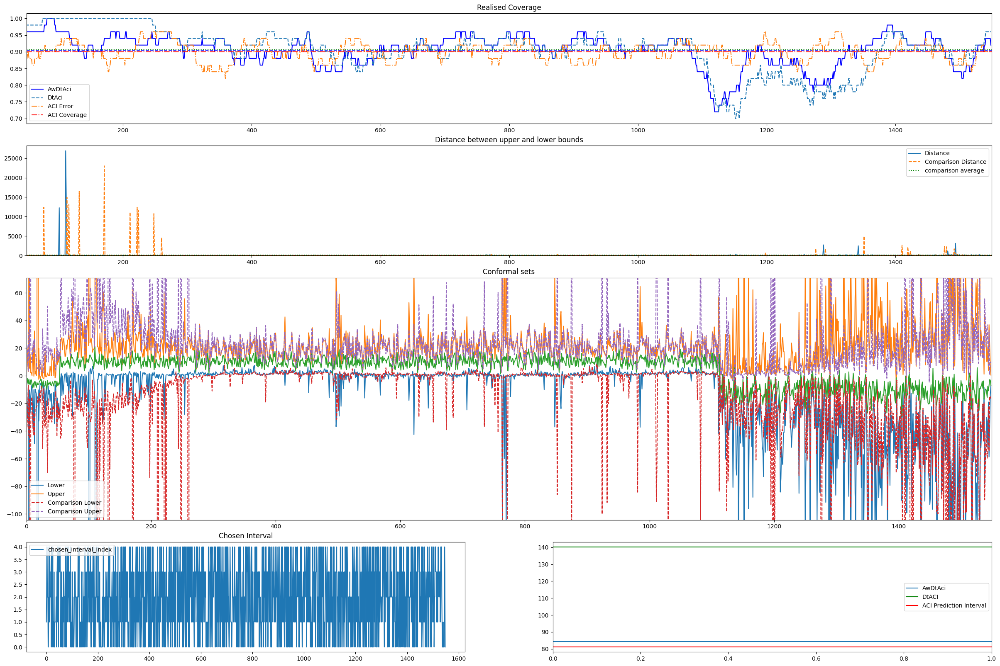

[np.float64(0.934934934934935), np.float64(0.9089089089089089), np.float64(1.0), np.float64(0.7347347347347347), np.float64(0.6836836836836837), np.float64(0.5595595595595595), np.float64(0.018018018018018056), np.float64(0.8098098098098099), np.float64(0.6486486486486487), np.float64(0.6486486486486487), np.float64(0.8548548548548549), np.float64(0.6856856856856857), np.float64(0.7627627627627628), np.float64(0.3263263263263263), np.float64(0.2492492492492493), np.float64(0.8228228228228228), np.float64(0.21321321321321318), np.float64(0.17517517517517522), np.float64(0.6306306306306306), np.float64(0.4864864864864865), np.float64(0.011011011011010985), np.float64(0.2862862862862863), np.float64(0.8748748748748749), np.float64(0.973973973973974), np.float64(0.5225225225225225), np.float64(0.07507507507507505), np.float64(0.5835835835835836), np.float64(0.6376376376376376), np.float64(0.3533533533533534), np.float64(0.37537537537537535), np.float64(0.20020020020020024), np.float64(0.97

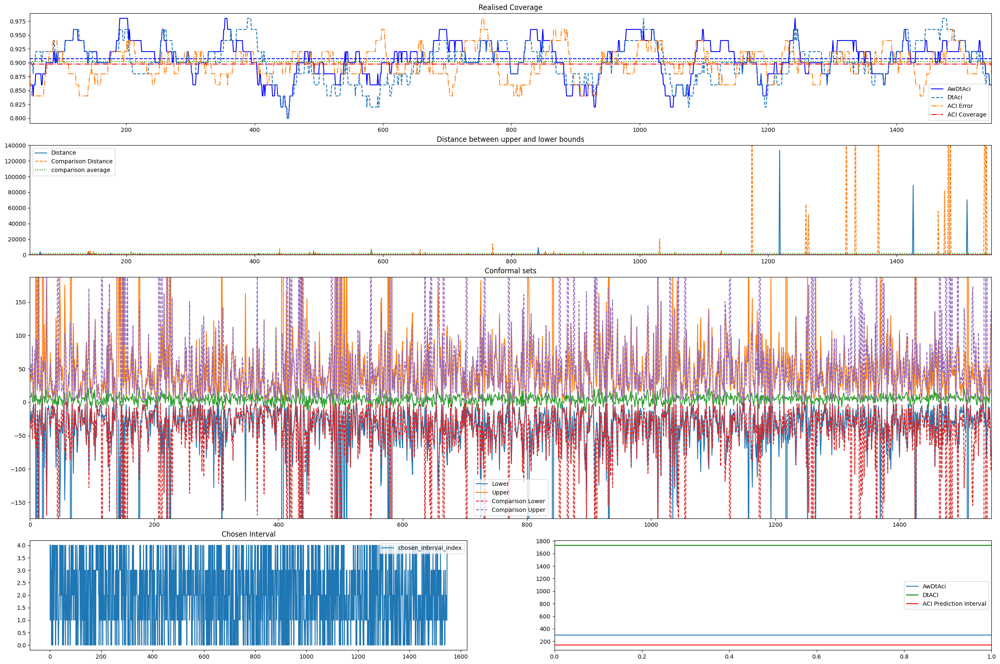

[np.float64(0.6356356356356356), np.float64(0.41141141141141147), np.float64(0.7227227227227226), np.float64(0.4354354354354354), np.float64(0.5655655655655656), np.float64(0.21021021021021025), np.float64(0.7947947947947948), np.float64(0.8328328328328328), np.float64(0.6286286286286287), np.float64(0.1871871871871872), np.float64(0.5635635635635636), np.float64(0.2792792792792793), np.float64(0.2552552552552553), np.float64(0.991991991991992), np.float64(0.14214214214214216), np.float64(0.14214214214214216), np.float64(0.6196196196196196), np.float64(0.12612612612612617), np.float64(0.03903903903903905), np.float64(0.29229229229229226), np.float64(0.3263263263263263), np.float64(0.5245245245245245), np.float64(0.0780780780780781), np.float64(0.8448448448448449), np.float64(0.8768768768768769), np.float64(0.3733733733733734), np.float64(0.12112112112112117), np.float64(0.5485485485485486), np.float64(0.027027027027027084), np.float64(0.19019019019019023), np.float64(0.0190190190190190

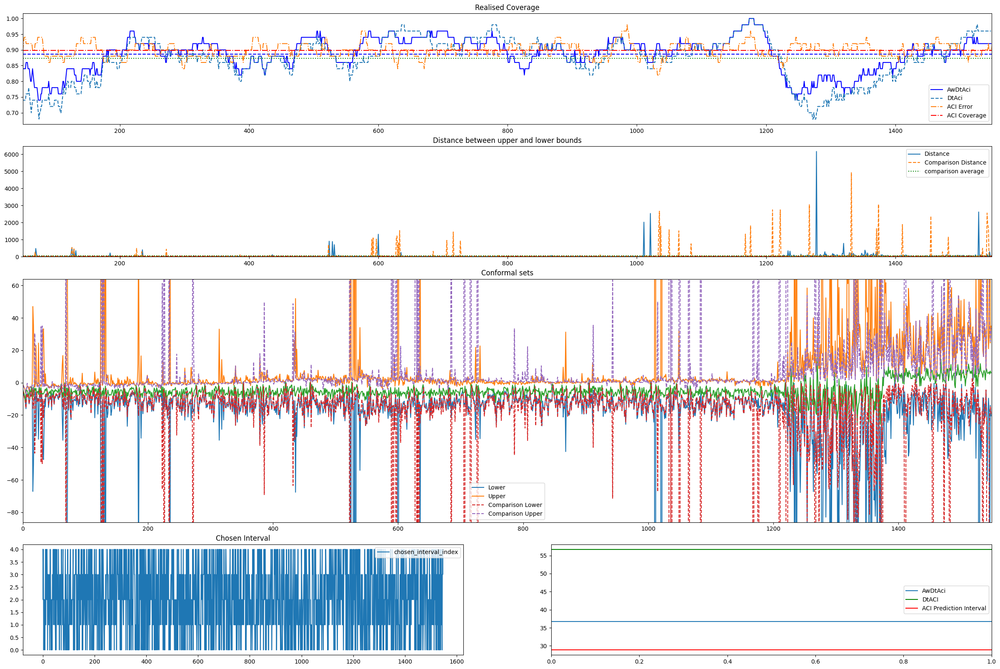

UnboundLocalError: cannot access local variable 'B_t' where it is not associated with a value

In [23]:
all_random = ACP_data.random_multi_shift(20, (2000,2001))

cov = []
interval = []

for data in all_random:
    result = t.AwDtAci(data)
    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    AwDT_plot(result, data, True)

    


[np.float64(0.024024024024024038), np.float64(0.3613613613613613), np.float64(0.6136136136136137), np.float64(0.034034034034034044), np.float64(0.5995995995995996), np.float64(0.9139139139139139), np.float64(0.48548548548548554), np.float64(0.06106106106106102), np.float64(0.3773773773773774), np.float64(0.46946946946946944), np.float64(0.3113113113113113), np.float64(0.3153153153153153), np.float64(0.20820820820820818), np.float64(0.8508508508508509), np.float64(0.29329329329329334), np.float64(0.7857857857857857), np.float64(0.10010010010010006), np.float64(0.4664664664664665), np.float64(0.7977977977977978), np.float64(0.08408408408408408), np.float64(0.9209209209209209), np.float64(0.5755755755755756), np.float64(0.002002002002001957), np.float64(0.8408408408408409), np.float64(0.5215215215215215), np.float64(0.993993993993994), np.float64(0.8358358358358359), np.float64(0.3213213213213213), np.float64(0.5355355355355356), np.float64(0.03903903903903905), np.float64(0.6126126126126

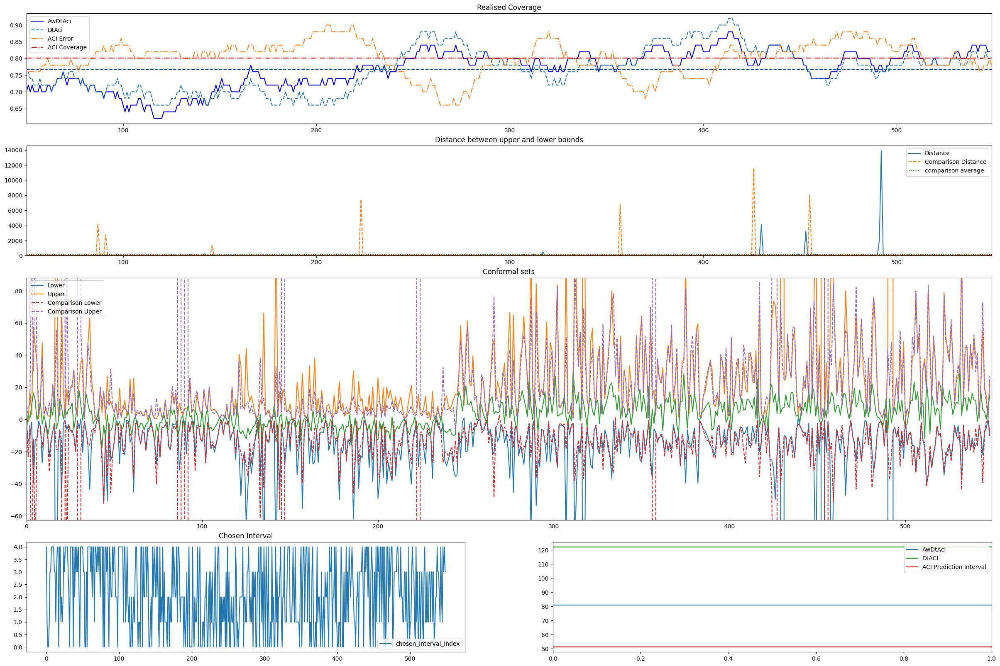

[np.float64(0.4194194194194194), np.float64(0.5175175175175175), np.float64(0.7957957957957957), np.float64(0.09809809809809811), np.float64(0.3013013013013013), np.float64(0.8048048048048049), np.float64(0.8948948948948949), np.float64(0.5715715715715716), np.float64(0.6386386386386387), np.float64(0.8198198198198199), np.float64(0.40240240240240244), np.float64(0.1501501501501502), np.float64(0.47447447447447444), np.float64(0.2592592592592593), np.float64(0.31831831831831836), np.float64(0.2802802802802803), np.float64(0.6026026026026026), np.float64(0.7497497497497497), np.float64(0.2852852852852853), np.float64(0.7307307307307307), np.float64(0.1911911911911912), np.float64(0.6636636636636637), np.float64(0.9189189189189189), np.float64(0.07007007007007005), np.float64(0.8648648648648649), np.float64(0.3623623623623624), np.float64(0.019019019019019034), np.float64(0.5145145145145145), np.float64(0.09609609609609615), np.float64(0.7877877877877878), np.float64(1.0), np.float64(0.8

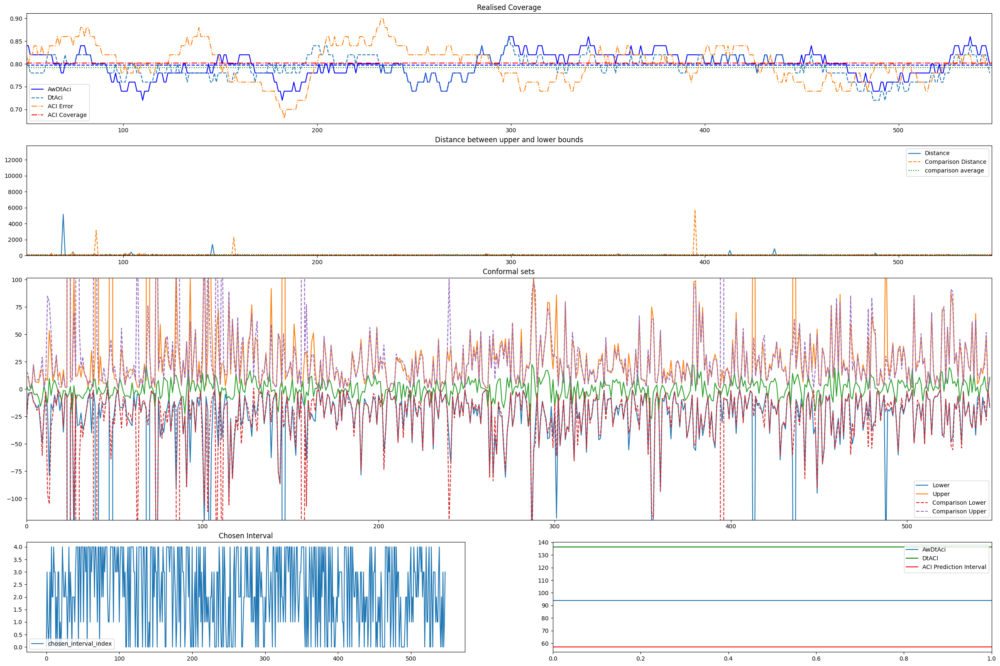

[np.float64(0.34434434434434436), np.float64(0.11711711711711714), np.float64(0.7727727727727728), np.float64(0.00800800800800805), np.float64(0.12012012012012008), np.float64(0.10310310310310311), np.float64(0.07407407407407407), np.float64(0.17817817817817816), np.float64(0.040040040040040026), np.float64(0.1861861861861862), np.float64(0.16716716716716717), np.float64(0.14314314314314314), np.float64(0.02102102102102099), np.float64(0.42342342342342343), np.float64(0.19619619619619622), np.float64(0.05805805805805808), np.float64(0.3993993993993994), np.float64(0.05305305305305308), np.float64(0.10610610610610616), np.float64(0.1511511511511512), np.float64(0.24624624624624625), np.float64(0.5105105105105106), np.float64(0.5105105105105106), np.float64(0.7377377377377378), np.float64(0.5155155155155156), np.float64(0.5155155155155156), np.float64(0.5925925925925926), np.float64(0.055055055055055035), np.float64(0.3943943943943944), np.float64(0.2272272272272272), np.float64(0.962962

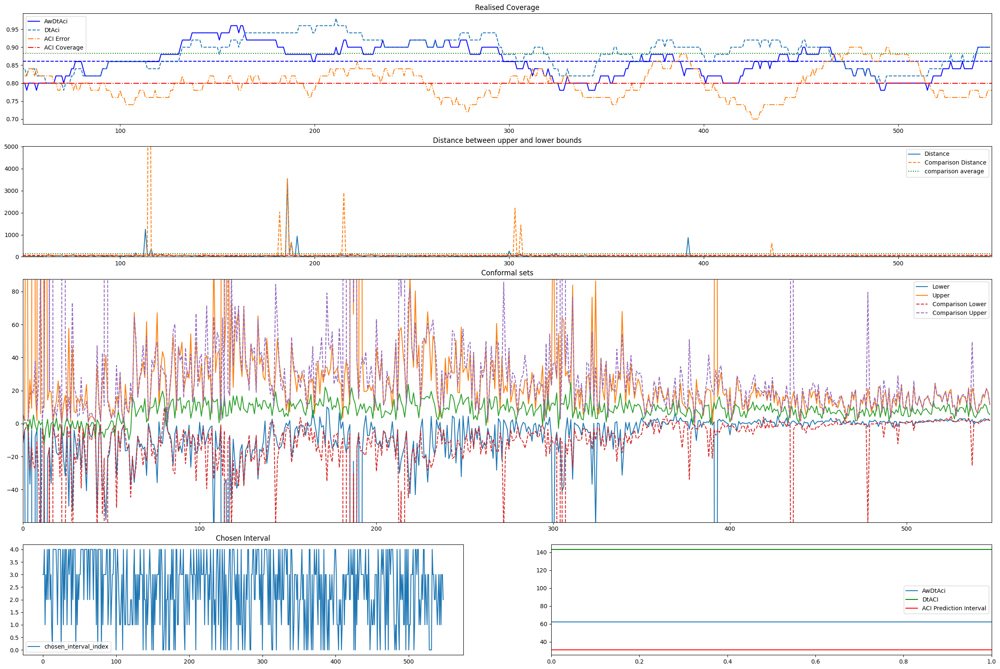

[np.float64(0.8308308308308309), np.float64(0.5525525525525525), np.float64(0.17417417417417413), np.float64(0.15215215215215216), np.float64(0.8358358358358359), np.float64(0.7537537537537538), np.float64(0.07407407407407407), np.float64(0.6386386386386387), np.float64(0.31931931931931934), np.float64(0.06006006006006004), np.float64(0.32432432432432434), np.float64(0.22122122122122123), np.float64(0.1501501501501502), np.float64(0.7507507507507507), np.float64(0.6846846846846847), np.float64(0.30930930930930933), np.float64(0.7657657657657657), np.float64(0.21621621621621623), np.float64(0.47947947947947944), np.float64(0.35935935935935936), np.float64(0.9179179179179179), np.float64(0.4984984984984985), np.float64(0.1811811811811812), np.float64(0.8578578578578578), np.float64(0.7627627627627628), np.float64(0.41141141141141147), np.float64(0.8438438438438438), np.float64(0.21121121121121122), np.float64(0.2842842842842843), np.float64(0.6226226226226226), np.float64(0.7317317317317

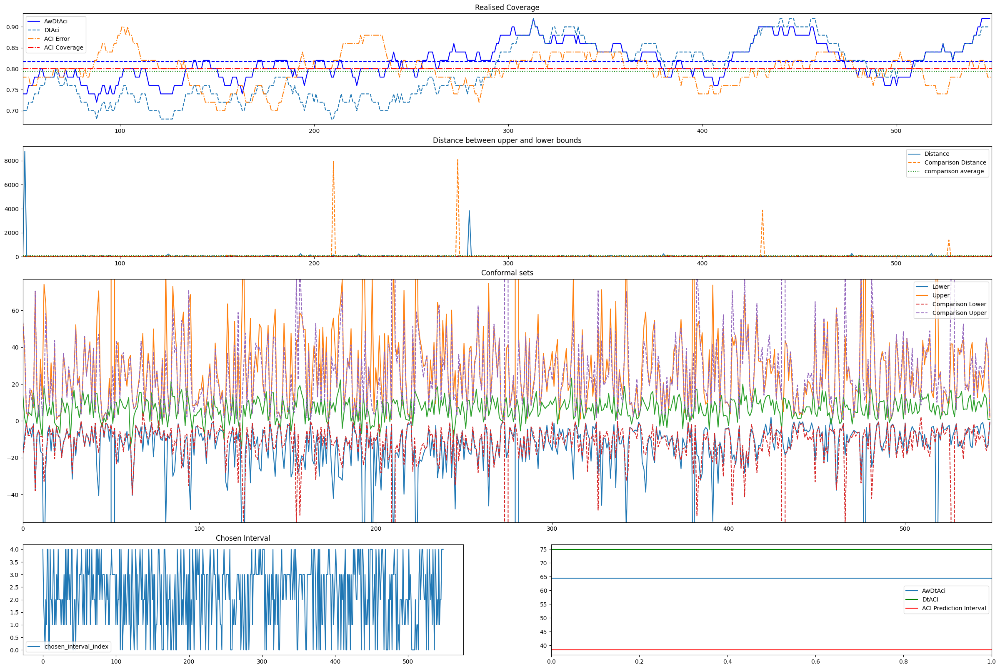

[np.float64(0.7197197197197197), np.float64(0.5725725725725725), np.float64(0.6486486486486487), np.float64(0.38038038038038036), np.float64(0.049049049049049054), np.float64(0.47347347347347346), np.float64(0.06906906906906907), np.float64(0.9529529529529529), np.float64(0.8418418418418419), np.float64(0.8418418418418419), np.float64(0.8538538538538538), np.float64(0.47347347347347346), np.float64(0.9239239239239239), np.float64(0.24224224224224222), np.float64(0.14814814814814814), np.float64(0.8398398398398399), np.float64(0.5055055055055055), np.float64(0.978978978978979), np.float64(0.2642642642642643), np.float64(0.6936936936936937), np.float64(0.8558558558558559), np.float64(0.29829829829829835), np.float64(0.8278278278278278), np.float64(0.36536536536536535), np.float64(0.0010010010010009784), np.float64(0.7247247247247247), np.float64(0.28228228228228225), np.float64(0.03703703703703709), np.float64(0.6266266266266266), np.float64(0.4354354354354354), np.float64(0.897897897897

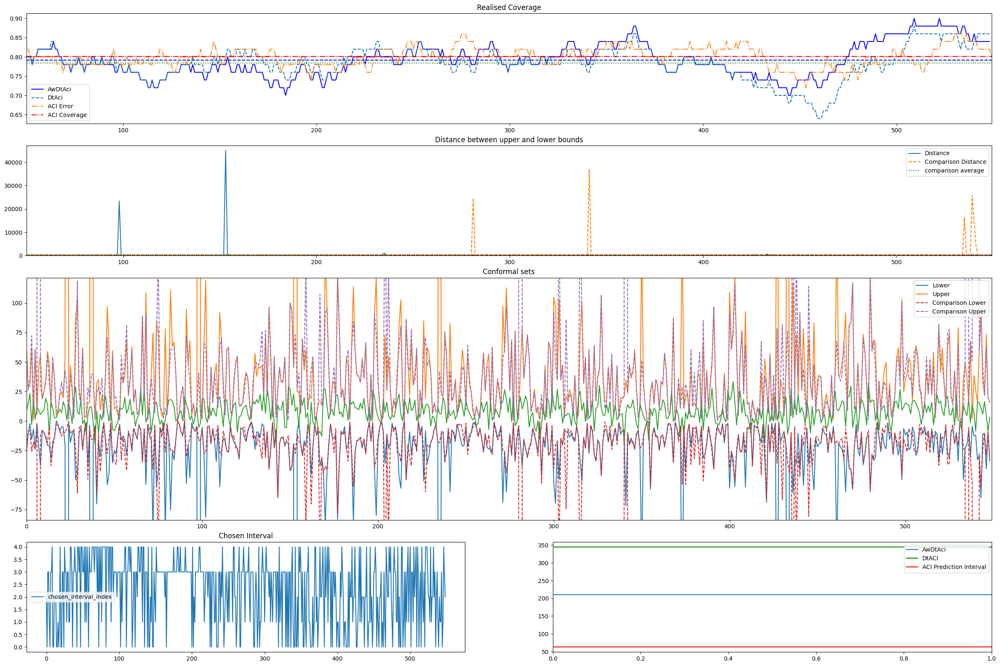

[np.float64(0.03903903903903905), np.float64(0.3983983983983984), np.float64(0.17417417417417413), np.float64(0.6296296296296297), np.float64(0.06506506506506504), np.float64(0.6096096096096096), np.float64(0.03903903903903905), np.float64(0.6016016016016016), np.float64(0.06306306306306309), np.float64(0.43843843843843844), np.float64(0.7217217217217218), np.float64(0.13713713713713716), np.float64(0.48048048048048053), np.float64(0.7187187187187187), np.float64(0.7857857857857857), np.float64(0.26126126126126126), np.float64(0.7947947947947948), np.float64(0.8538538538538538), np.float64(0.7347347347347347), np.float64(0.8588588588588588), np.float64(0.2392392392392393), np.float64(0.4824824824824825), np.float64(0.1351351351351351), np.float64(0.3683683683683684), np.float64(0.5935935935935936), np.float64(0.21821821821821819), np.float64(0.18318318318318316), np.float64(0.3683683683683684), np.float64(0.5895895895895895), np.float64(0.08208208208208212), np.float64(0.75275275275275

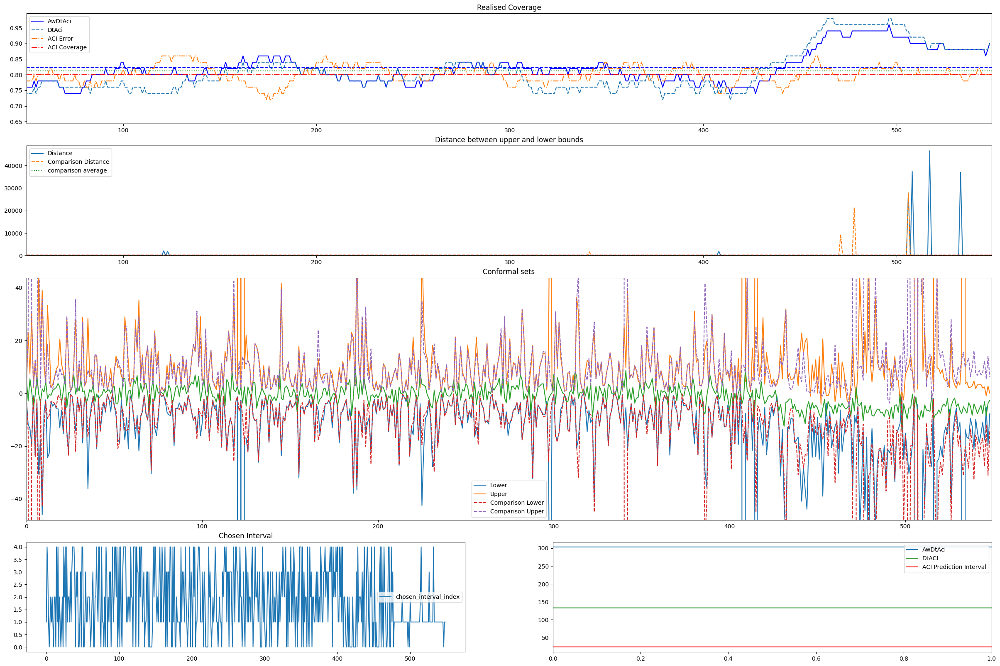

KeyboardInterrupt: 

In [ ]:
all_random = ACP_data.random_multi_shift(10, (1000,1001), number_shift_range=(2,8))

cov = []
interval = []
results = []
t2 = test(0.2)

for data in all_random:
    result = t2.AwDtAci(data)

    results.append(result)

    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    AwDT_plot(result, data, True)


So it consistently outperforms DtACI but does not outperfrom ACI itself, this is no suprise as DtACI does not outperform ACI itself so there is no way that it would anyway. Reelook at DTACI paper
.

# Testing when it chooses to shift

[np.float64(0.18918918918918914), np.float64(0.3363363363363363), np.float64(0.6836836836836837), np.float64(0.44744744744744747), np.float64(0.031031031031030998), np.float64(0.5245245245245245), np.float64(0.08008008008008005), np.float64(0.8208208208208209), np.float64(0.96996996996997), np.float64(0.9379379379379379), np.float64(0.11811811811811812), np.float64(0.44344344344344344), np.float64(0.5315315315315315), np.float64(0.00800800800800805), np.float64(0.5645645645645645), np.float64(0.8588588588588588), np.float64(0.3473473473473474), np.float64(0.031031031031030998), np.float64(0.8058058058058057), np.float64(0.973973973973974), np.float64(0.6896896896896897), np.float64(0.10310310310310311), np.float64(0.5535535535535536), np.float64(0.08908908908908908), np.float64(0.25625625625625625), np.float64(0.19619619619619622), np.float64(0.7297297297297297), np.float64(0.4554554554554555), np.float64(0.04504504504504503), np.float64(0.38638638638638634), np.float64(0.3193193193193

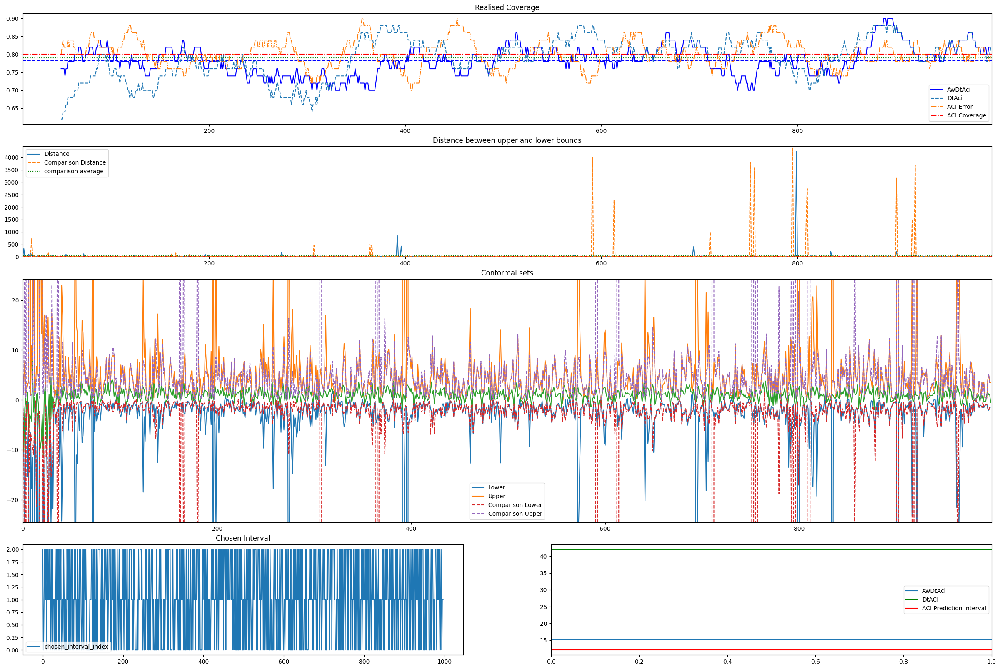

[np.float64(0.17017017017017022), np.float64(0.7847847847847848), np.float64(0.5125125125125125), np.float64(0.8138138138138138), np.float64(0.13313313313313313), np.float64(0.3723723723723724), np.float64(1.0), np.float64(0.7967967967967968), np.float64(0.6526526526526526), np.float64(0.08008008008008005), np.float64(0.1761761761761762), np.float64(0.5395395395395395), np.float64(0.21821821821821819), np.float64(0.3983983983983984), np.float64(0.5815815815815816), np.float64(0.3563563563563563), np.float64(0.6006006006006006), np.float64(0.6006006006006006), np.float64(0.6766766766766767), np.float64(0.6806806806806807), np.float64(0.29729729729729726), np.float64(0.10410410410410409), np.float64(0.9189189189189189), np.float64(0.33933933933933935), np.float64(0.27227227227227224), np.float64(0.8188188188188188), np.float64(0.41241241241241244), np.float64(0.8668668668668669), np.float64(0.924924924924925), np.float64(1.0), np.float64(0.8518518518518519), np.float64(0.5045045045045045

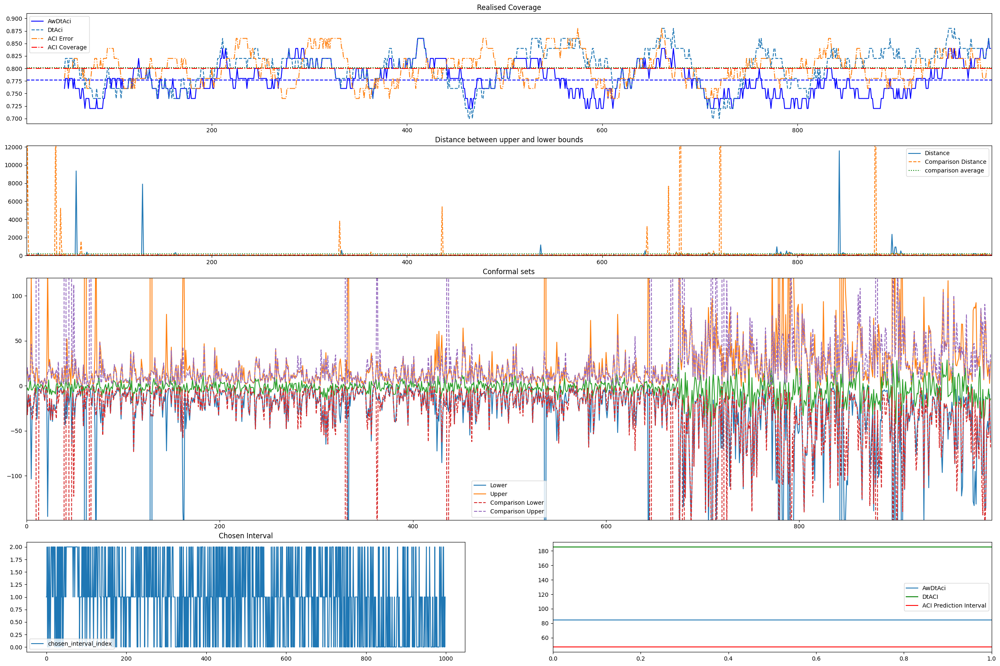

[np.float64(0.3363363363363363), np.float64(0.914914914914915), np.float64(0.4964964964964965), np.float64(0.5235235235235236), np.float64(0.4814814814814815), np.float64(0.3483483483483484), np.float64(0.35935935935935936), np.float64(0.7837837837837838), np.float64(0.9819819819819819), np.float64(0.46946946946946944), np.float64(0.5865865865865866), np.float64(0.8128128128128128), np.float64(0.990990990990991), np.float64(0.48048048048048053), np.float64(0.7307307307307307), np.float64(0.4184184184184184), np.float64(0.48948948948948945), np.float64(0.8448448448448449), np.float64(0.17517517517517522), np.float64(0.6686686686686687), np.float64(0.1861861861861862), np.float64(0.49549549549549554), np.float64(0.8908908908908909), np.float64(0.3723723723723724), np.float64(0.5115115115115115), np.float64(0.11711711711711714), np.float64(0.4104104104104104), np.float64(0.4764764764764765), np.float64(0.4764764764764765), np.float64(0.7107107107107107), np.float64(0.28828828828828834), n

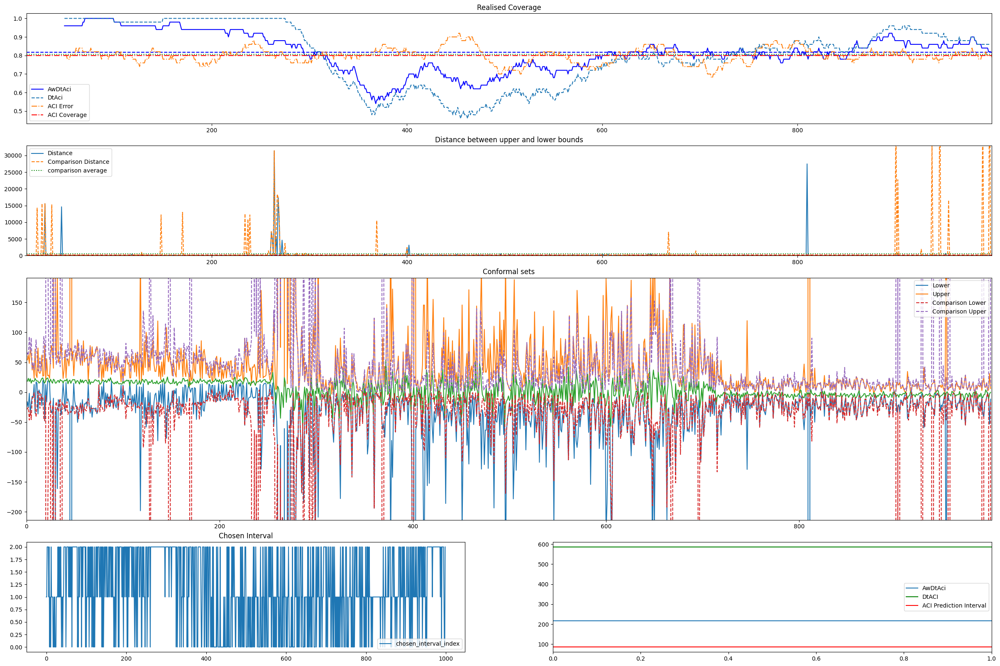

[np.float64(0.6746746746746747), np.float64(0.3673673673673674), np.float64(0.2602602602602603), np.float64(0.026026026026025995), np.float64(0.7917917917917918), np.float64(0.5565565565565566), np.float64(0.28728728728728725), np.float64(0.012012012012012074), np.float64(0.953953953953954), np.float64(0.8568568568568569), np.float64(0.7907907907907907), np.float64(0.6616616616616617), np.float64(0.988988988988989), np.float64(0.6016016016016016), np.float64(0.6596596596596597), np.float64(0.41741741741741745), np.float64(0.4254254254254254), np.float64(0.7377377377377378), np.float64(0.5325325325325325), np.float64(0.23623623623623624), np.float64(0.04504504504504503), np.float64(0.8008008008008007), np.float64(0.2022022022022022), np.float64(0.1511511511511512), np.float64(0.1511511511511512), np.float64(0.45345345345345345), np.float64(0.3463463463463463), np.float64(0.10710710710710714), np.float64(0.44244244244244246), np.float64(0.1341341341341341), np.float64(0.8548548548548549)

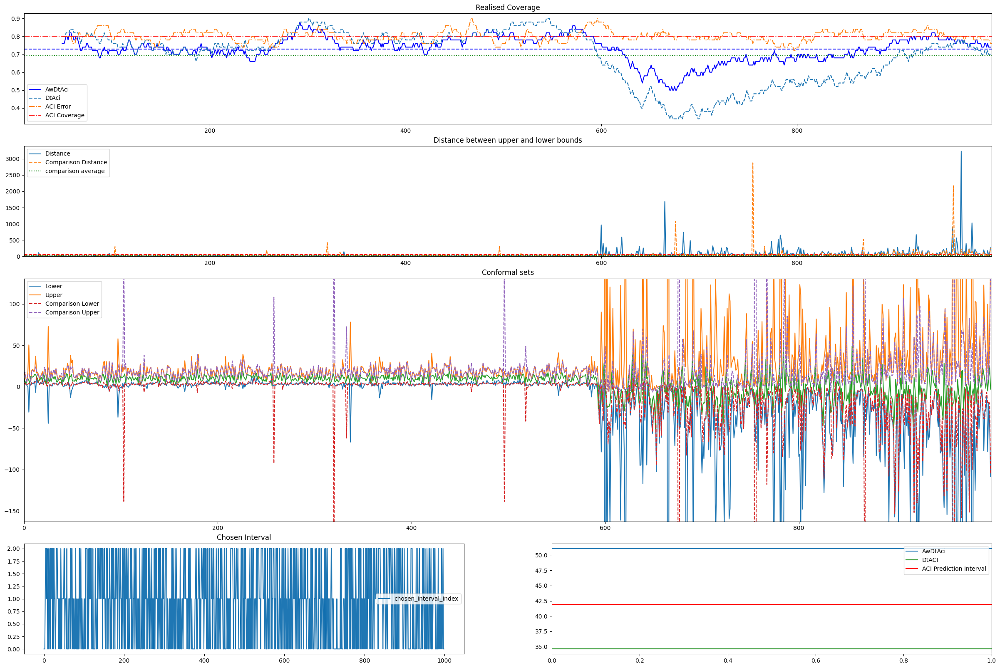

UnboundLocalError: cannot access local variable 'B_t' where it is not associated with a value

In [ ]:
# Similar data but will allow the changes to be a lot more pronounced so can better see the effects.
all_random = ACP_data.random_multi_shift(10, (1500,1501), dist_range=((-10, 1), (20, 20)), number_shift_range=(2,4))

cov = []
interval = []
results = []

t2 = test(0.2)

for data in all_random:
    result = t2.AwDtAci(data, [10, 250, 500])

    results.append(result)

    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    AwDT_plot(result, data, True)